<a href="https://colab.research.google.com/github/MohammedAlsabaa/LAB05/blob/master/ICS471_PP2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Project purpose
Our project focuses on developing a music genre classification system using deep learning techniques. The objective is to create a model that can accurately determine the genre of a given music track. To achieve this, we have selected the GTZAN dataset, a renowned benchmark dataset for music genre classification.

The database link:
https://www.kaggle.com/datasets/andradaolteanu/gtzan-dataset-music-genre-classification

The dataset consists of 10 output genres which are blues, classical, country, disco, hip-hop, jazz, metal, pop, reggae, and rock.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Extract data
!unzip '/content/drive/MyDrive/Data_Audio.zip'

##1- Import librarys

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.utils import Sequence
from tensorflow import pad, expand_dims

import os
import seaborn as sns
import pandas as pd
import numpy as np
import librosa
import IPython
from IPython.display import Audio
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
import librosa.display as lplt
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, classification_report
from torchaudio import load
from torch.utils.data import DataLoader

import matplotlib.pyplot as plt

In [ ]:
class MusicDataset(Sequence):
    def __init__(self, root_dir):
        self.root_dir = root_dir
        self.classes = os.listdir(root_dir)
        self.class_to_idx = {cls: idx for idx, cls in enumerate(self.classes)}
        self.file_list = self._make_dataset()

    def _make_dataset(self):
        file_list = []
        for i, cls in enumerate(self.classes):
            class_dir = os.path.join(self.root_dir, cls)
            for root, _, fnames in sorted(os.walk(class_dir)):
                fnames = sorted(fnames)
                for fname in fnames:
                    if fname.lower().endswith('.wav'):
                        path = os.path.join(root, fname)
                        try:
                          waveform, _ = load(path)
                          file_list.append((waveform, self.class_to_idx[cls]))
                        except:
                          print(f"The following music path is corrupted: {path}")
        return file_list

    def __len__(self):
        return len(self.file_list)

    def __getitem__(self, idx):
      return self.file_list[idx]

##2- LoadData

In [ ]:
data_dir = '/content/Data_Audio/genres_original'

# Create the dataset
music_dataset = MusicDataset(root_dir=data_dir)

# Create the split measurement the data into 70/15/15
total_size = len(music_dataset)
train_size = int(0.7 * total_size)
valtest_size = total_size - train_size
val_size = int(0.5 * valtest_size)
test_size = valtest_size - val_size

# Set a random seed
random_seed = 777

# Split the data into 70/15/15
train_data, valtest_data = train_test_split(music_dataset, test_size=valtest_size, random_state=random_seed, shuffle=False)
val_data, test_data = train_test_split(valtest_data, test_size=test_size, random_state=random_seed, shuffle=False)

The following music path is corrupted: /content/Data_Audio/genres_original/jazz/jazz.00054.wav


In [ ]:
classes = os.listdir(data_dir)
print(classes)

['jazz', 'metal', 'classical', 'pop', 'disco', 'hiphop', 'blues', 'country', 'rock', 'reggae']


In [ ]:
print(f"Number of training samples: {len(train_data)}")
print(f"Number of validation samples: {len(val_data)}")
print(f"Number of test samples: {len(test_data)}")

Number of training samples: 699
Number of validation samples: 150
Number of test samples: 150


In [ ]:
train_dataloader = DataLoader(train_data, batch_size=32, shuffle=True)
val_dataloader = DataLoader(val_data, batch_size=32, shuffle=False)
test_dataloader = DataLoader(test_data, batch_size=32, shuffle=False)

##2.1- Display sample from each folder\class

-----------------------------------------------------------------------------------------
jazz genre: 


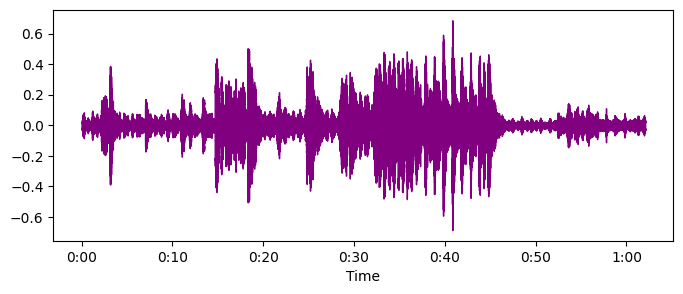

-----------------------------------------------------------------------------------------
metal genre: 


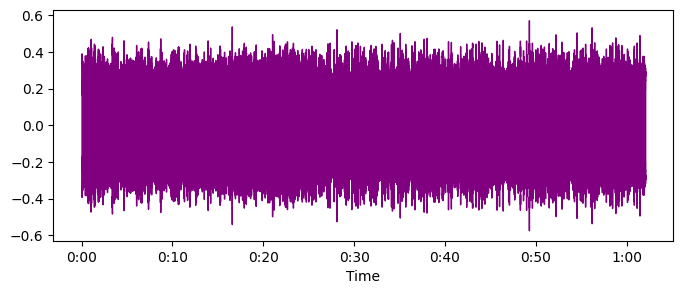

-----------------------------------------------------------------------------------------
classical genre: 


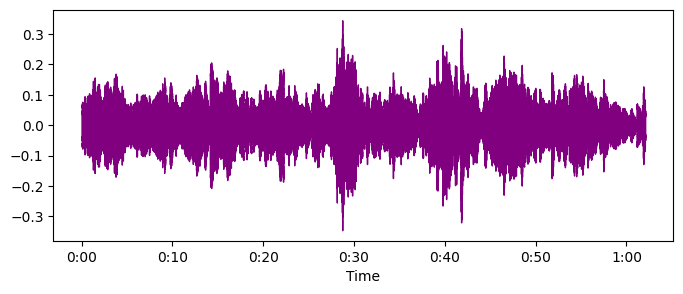

-----------------------------------------------------------------------------------------
pop genre: 


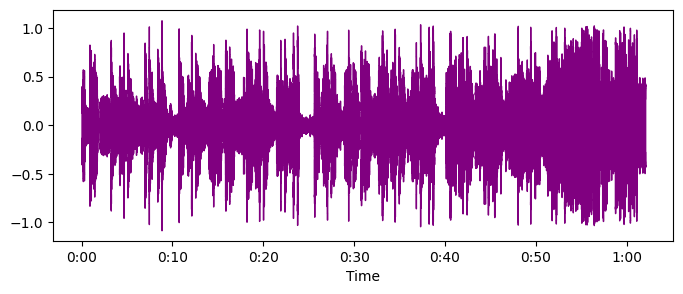

-----------------------------------------------------------------------------------------
disco genre: 


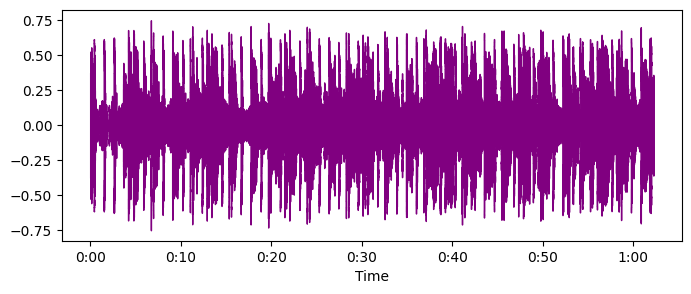

-----------------------------------------------------------------------------------------
hiphop genre: 


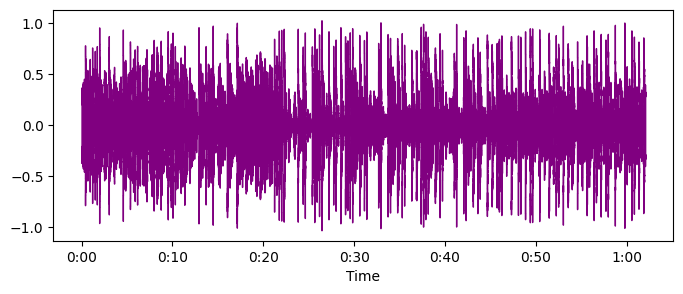

-----------------------------------------------------------------------------------------
blues genre: 


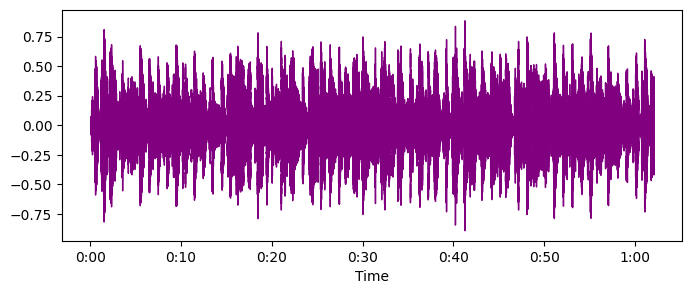

-----------------------------------------------------------------------------------------
country genre: 


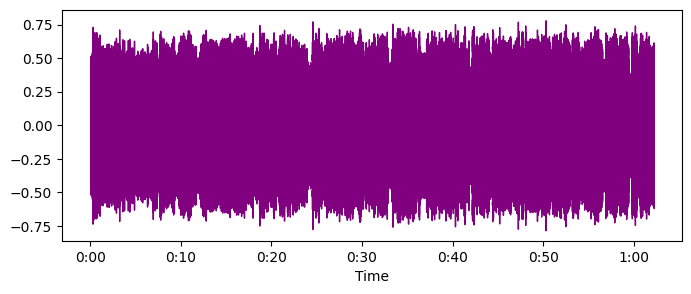

-----------------------------------------------------------------------------------------
rock genre: 


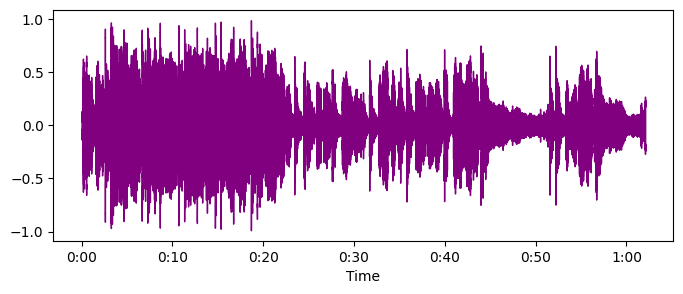

-----------------------------------------------------------------------------------------
reggae genre: 


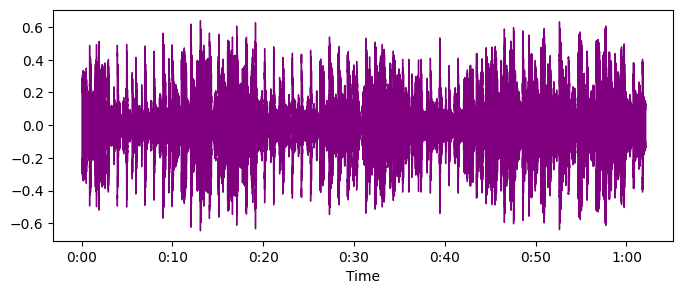

In [ ]:
for c in classes:
  path = f'/content/Data_Audio/genres_original/{c}/{c}.00000.wav'
  print("-" * 89)
  print(f"{c} genre: ")
  waveform, sample_rate = librosa.load(path, sr=45600)
  display(Audio(waveform, rate=sample_rate))
  plt.figure(figsize=(8,3))
  librosa.display.waveshow(waveform, color = "Purple")
  plt.show()

##2.2- Data statistics

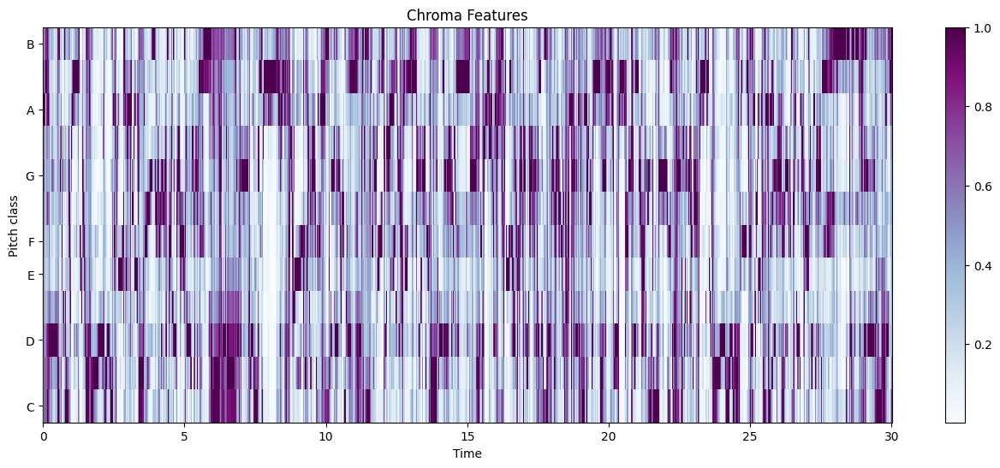

In [ ]:
# A chromagram is a representation of the energy distribution of pitch classes (or musical notes) in an audio signal.
# It is a feature commonly used in music analysis and audio signal processing.
# The chromagram provides information about the harmonic content of a piece of music and can be useful for tasks such as music genre classification, chord recognition, and melody extraction.
path = f'/content/Data_Audio/genres_original/blues/blues.00000.wav'
waveform, sample_rate = librosa.load(path, sr=45600)
chroma = librosa.feature.chroma_stft(y=waveform, sr=sample_rate)

# Plot the chromagram
plt.figure(figsize=(16, 6))
librosa.display.specshow(chroma, sr=sample_rate, x_axis='time', y_axis='chroma', cmap='BuPu')
plt.colorbar()
plt.title("Chroma Features")
plt.show()

##3- CNN module

In [ ]:
data_dir = 'C:/Users/ntech/OneDrive/Desktop/CNN/archive/Data/images_original'
classes = os.listdir(data_dir)
num_classes = len(classes)

# Initialize lists to store images and labels
images = []
labels = []

# Load images and labels
for idx, class_name in enumerate(classes):
    class_dir = os.path.join(data_dir, class_name)
    for img_name in os.listdir(class_dir):
        img_path = os.path.join(class_dir, img_name)
        img = cv2.imread(img_path)  # Read image using OpenCV or any image library
        # Preprocess image (resize, normalize, etc.) if needed
        images.append(img)
        labels.append(idx)  # Assign label based on class index

# Convert lists to NumPy arrays
images = np.array(images)
labels = np.array(labels)


In [ ]:
import os
import cv2

data_dir = 'C:/Users/ntech/OneDrive/Desktop/CNN/archive/Data/images_original'

# Choose a sample image path from one of the classes
sample_class = os.listdir(data_dir)[0]  # Assuming you take the first class
sample_image = os.listdir(os.path.join(data_dir, sample_class))[0]  # Taking the first image in that class

sample_image_path = os.path.join(data_dir, sample_class, sample_image)
sample_img = cv2.imread(sample_image_path)  # Read the sample image

# Get dimensions of the sample image
IMG_HEIGHT, IMG_WIDTH, _ = sample_img.shape
print(f"Image dimensions: Height - {IMG_HEIGHT}, Width - {IMG_WIDTH}")


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(288, 432, 3)),
    MaxPooling2D((2, 2)),
    # Add more Conv2D and MaxPooling2D layers as needed
    Flatten(),
    Dense(num_classes, activation='softmax')  # Output layer with num_classes units
])

# Compile the model
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])


##4- Training & Validation

In [ ]:
batch_size = 32
epochs = 10

history = model.fit(images, labels,
                    batch_size=batch_size,
                    epochs=epochs,
                    validation_split=0.2)

##5- Tuning hyperparamers

##6- Testing

## 7- Statistics